In [1]:
!pip install boto3

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.7/132.7 KB 1.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.6/79.6 KB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 23.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.6/140.6 KB 4.3 MB/s eta 0:00:00
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import boto3
import yaml
import plotly.express as px

from matplotlib.ticker import FuncFormatter

In [3]:
def number_formatter(number, pos=None):
    """Convert a number into a human readable format."""
    magnitude = 0
    while abs(number) >= 1000:
        magnitude += 1
        number /= 1000.0
    return '%.1f%s' % (number, ['', 'K', 'M', 'B', 'T', 'Q'][magnitude])

In [4]:
with open("credentials.yaml", "r") as f:
    config = yaml.safe_load(f)

In [7]:
def cargar_datos_s3(bucket, bucket_path):
    session = boto3.Session(
        aws_access_key_id = config['s3']['aws_access_key_id'],
        aws_secret_access_key = config['s3']['aws_secret_access_key'],
        aws_session_token = config['s3']['aws_session_token']
    )

    s3 = session.resource('s3')
    
    obj = s3.Object(bucket, bucket_path).get()['Body'].read()
    dataset = pickle.loads(obj)
    
    return dataset

In [9]:
session = boto3.Session(
    aws_access_key_id = config['s3']['aws_access_key_id'],
    aws_secret_access_key = config['s3']['aws_secret_access_key'],
    aws_session_token = config['s3']['aws_session_token']
)

s3 = session.client('s3')

In [10]:
bucket = "aplicaciones-cd-1-" + config['iexe']['matricula']
key = "limpieza/"

In [11]:
bucket_path = s3.list_objects_v2(Bucket=bucket, Prefix=key)['Contents'][-1]['Key']

In [12]:
bucket_path

'limpieza/datos-limpios-2023-02-13.pkl'

In [13]:
dataset = cargar_datos_s3(bucket, bucket_path)

In [14]:
dataset.head()

,inspection_id,dba_name,aka_name,license_,facility_type,risk,address,city,state,zip,inspection_date,inspection_type,results,latitude,longitude,location,violations
0,52234,Cafe 608,Cafe 608,2013328,Restaurant,Risk 1 (High),608 W BARRY AVE,CHICAGO,IL,60657,2010-01-04,License Re-Inspection,Pass,41.938007,-87.644755,"{'latitude': '41.938006880423615', 'longitude'...",NaN
1,67733,WOLCOTT'S,TROQUET,1992040,Restaurant,Risk 1 (High),1834 W MONTROSE AVE,CHICAGO,IL,60613,2010-01-04,License Re-Inspection,Pass,41.961606,-87.675967,"{'latitude': '41.961605669949854', 'longitude'...",NaN
2,70269,mr.daniel's,mr.daniel's,1899292,Restaurant,Risk 1 (High),5645 W BELMONT AVE,CHICAGO,IL,60634,2010-01-04,License Re-Inspection,Pass,41.938443,-87.768318,"{'latitude': '41.93844282365204', 'longitude':...",NaN
3,67757,DUNKIN DONUTS/BASKIN-ROBBINS,DUNKIN DONUTS/BASKIN-ROBBINS,1380279,Restaurant,Risk 2 (Medium),100 W RANDOLPH ST,CHICAGO,IL,60601,2010-01-04,Tag Removal,Pass,41.884586,-87.631010,"{'latitude': '41.88458626715456', 'longitude':...",NaN
4,67732,WOLCOTT'S,TROQUET,1992039,Restaurant,Risk 1 (High),1834 W MONTROSE AVE,CHICAGO,IL,60613,2010-01-04,License Re-Inspection,Pass,41.961606,-87.675967,"{'latitude': '41.961605669949854', 'longitude'...",NaN


### 2. ¿Cuáles son los 5 tipos de establecimientos con más inspecciones en todo el dataset?

In [15]:
inspections_by_type_stablishment = dataset.groupby(['facility_type'], as_index=False)['inspection_id']\
.count()\
.rename(columns={'inspection_id': 'count'})\
.sort_values(by="count", ascending=False)\
.head(5)

In [16]:
inspections_by_type_stablishment

,facility_type,count
391,Restaurant,167036
220,Grocery Store,31472
411,School,15186
2,0 Restaurant\ndtype: object,5023
115,Children's Services Facility,4955


[Text(0, 0, 'Restaurant'),
 Text(0, 0, 'Grocery Store'),
 Text(0, 0, 'School'),
 Text(0, 0, '0    Restaurant\ndtype: object'),
 Text(0, 0, "Children's Services Facility")]

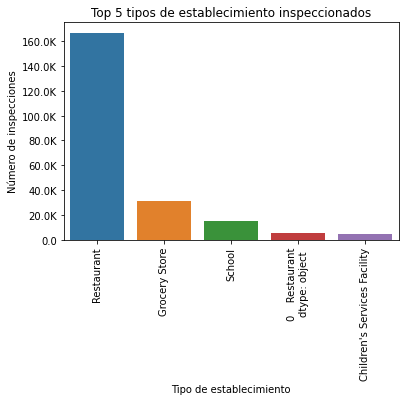

In [17]:
a = sns.barplot(x='facility_type', y='count', data=inspections_by_type_stablishment)
a.set_title("Top 5 tipos de establecimiento inspeccionados")
a.set_xlabel("Tipo de establecimiento")
a.set_ylabel("Número de inspecciones")
a.yaxis.set_major_formatter(FuncFormatter(number_formatter))
a.set_xticklabels(a.get_xticklabels(), rotation=90)

### 3. Cuántas inspecciones tienes por año

In [18]:
dataset['year_inspection'] = dataset.inspection_date.dt.year

In [19]:
dataset.dtypes

inspection_id               int64
dba_name                   object
aka_name                   object
license_                   object
facility_type              object
risk                       object
address                    object
city                       object
state                      object
zip                        object
inspection_date    datetime64[ns]
inspection_type            object
results                    object
latitude                  float64
longitude                 float64
location                   object
violations                 object
year_inspection             int64
dtype: object

In [20]:
inspections_by_year = dataset.groupby(['year_inspection'], as_index=False)['inspection_id']\
.count()\
.rename(columns={'inspection_id': 'count'})\
.sort_values(by="year_inspection")

In [21]:
inspections_by_year

,year_inspection,count
0,2010,18002
1,2011,18669
2,2012,18796
3,2013,20893
4,2014,21485
5,2015,20852
6,2016,22747
7,2017,21507
8,2018,17117
9,2019,18971


Text(0.5, 0, 'Año')

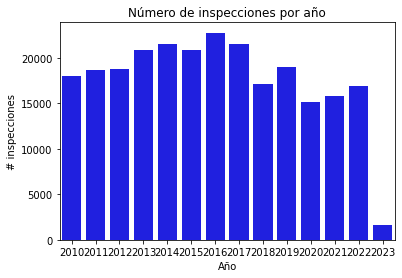

In [22]:
a = sns.barplot(x="year_inspection", y="count", data=inspections_by_year, color="blue")
a.set_title("Número de inspecciones por año")
a.set_ylabel('# inspecciones')
a.set_xlabel("Año")

### 4. ¿Cuáles son las 5 inspecciones que más se realizan?

In [23]:
top = dataset.groupby(['inspection_type'], as_index=False)['inspection_id']\
.count()\
.sort_values(by="inspection_id", ascending=False)\
.rename(columns={'inspection_id': 'count'})\
.head(5)

top

,inspection_type,count
15,Canvass,129972
44,License,33069
16,Canvass Re-Inspection,26886
17,Complaint,23401
45,License Re-Inspection,10788


[Text(0, 0, 'Canvass'),
 Text(0, 0, 'License'),
 Text(0, 0, 'Canvass Re-Inspection'),
 Text(0, 0, 'Complaint'),
 Text(0, 0, 'License Re-Inspection')]

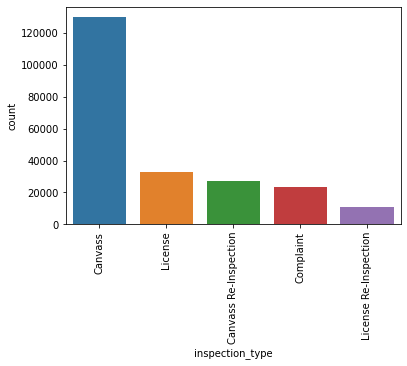

In [24]:
g = sns.barplot(x="inspection_type", y="count", data=top)
g.set_xticklabels(g.get_xticklabels(), rotation=90)

### 5. Del top 5 de tipos de inspecciones que hay en tu dataset, ¿qué porcentaje representa cada uno de estos tipos de inspecciones? Genera una gráfica de barras 


In [25]:
a = dataset.inspection_type.value_counts(normalize=True).sort_values(ascending=False).head(5)
a

Canvass                  0.523091
License                  0.133091
Canvass Re-Inspection    0.108207
Complaint                0.094181
License Re-Inspection    0.043418
Name: inspection_type, dtype: float64

In [26]:
b = pd.DataFrame({'inspection_type': a.index, 
                 'prop': a})
b

,inspection_type,prop
Canvass,Canvass,0.523091
License,License,0.133091
Canvass Re-Inspection,Canvass Re-Inspection,0.108207
Complaint,Complaint,0.094181
License Re-Inspection,License Re-Inspection,0.043418


(0.0, 1.0)

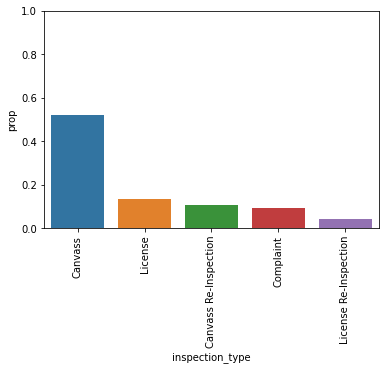

In [27]:
g = sns.barplot(x="inspection_type", y="prop", data=b)
g.set_xticklabels(g.get_xticklabels(), rotation=90)
g.set_ylim(0,1)

### 6. ¿Qué porcentaje de establecimientos tienes por cada tipo de resultado? Genera una gráfica de barras


In [28]:
a = dataset.results.value_counts(normalize=True)
a

Pass                    0.515104
Fail                    0.194023
Pass w/ Conditions      0.154139
Out of Business         0.085769
No Entry                0.038572
Not Ready               0.012078
Business Not Located    0.000314
Name: results, dtype: float64

In [29]:
b = pd.DataFrame({'result': a.index,
                 'prop': a})

(0.0, 1.0)

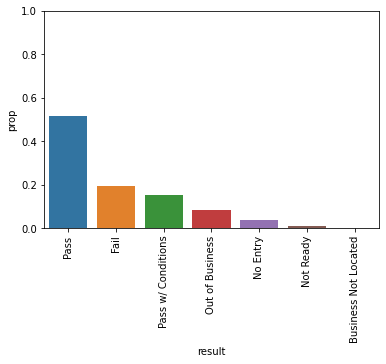

In [30]:
g = sns.barplot(x='result', y='prop', data=b)
g.set_xticklabels(g.get_xticklabels(), rotation=90)
g.set_ylim(0,1)

### 7. Mapa de inspecciones

In [31]:
px.set_mapbox_access_token(open(".mapbox_token").read())

FileNotFoundError: ignored

In [32]:
fig = px.scatter_mapbox(dataset, lat="latitude", lon="longitude", hover_name="city", color="results",
                        hover_data=["aka_name", "facility_type"], zoom=9, height=400, opacity=0.3)
fig.show()